# Start to end test

In [1]:
# Specify device
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0" 
# os.environ["CUDA_VISIBLE_DEVICES"] = ""  # For CPU inference
os.environ["TF_FORCE_GPU_ALLOW_GROWTH"]="true"

Before runing this test, please download models from [https://nomeroff.net.ua/models/](https://nomeroff.net.ua/models/) to **./models/** directory. 

In [2]:
# Import all necessary libraries.
import numpy as np
import sys
import glob
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2
from termcolor import colored

plt.rcParams["figure.figsize"] = (10,10)

In [3]:
# NomeroffNet path
NOMEROFF_NET_DIR = os.path.abspath('../')
sys.path.append(NOMEROFF_NET_DIR)

In [4]:
from NomeroffNet.BBoxNpPoints import NpPointsCraft, getCvZoneRGB, convertCvZonesRGBtoBGR, reshapePoints
#from NomeroffNet.BBoxNpPoints import NpPointsCraft
npPointsCraft = NpPointsCraft()
npPointsCraft.load()

Loading weights from checkpoint (/var/www/nomeroff-net/NomeroffNet/Base/mcm/./models/NpPointsCraft/mtl/craft_mlt_25k_2020-02-16.pth)
Loading weights of refiner from checkpoint (/var/www/nomeroff-net/NomeroffNet/Base/mcm/./models/NpPointsCraft/refiner/craft_refiner_CTW1500_2020-02-16.pth)


In [5]:
from NomeroffNet.YoloV5Detector import Detector

detector = Detector()
detector.load()

Fusing layers... 


In [7]:
from NomeroffNet.OptionsDetector import OptionsDetector

optionsDetector = OptionsDetector()
optionsDetector.load("../logs/best.pb")

In [8]:
from NomeroffNet.TextDetector import TextDetector
textDetector = TextDetector({
    "eu_ua_2004_2015": {
        "for_regions": ["eu_ua_2015", "eu_ua_2004"],
        "model_path": "latest"
    },
    "eu_ua_1995": {
        "for_regions": ["eu_ua_1995"],
        "model_path": "latest"
    },
    "eu": {
        "for_regions": ["eu"],
        "model_path": "latest"
    },
    "ru": {
        "for_regions": ["ru", "eu-ua-fake-lnr", "eu-ua-fake-dnr"],
        "model_path": "latest" 
    },
    "kz": {
        "for_regions": ["kz"],
        "model_path": "latest"
    },
    "ge": {
        "for_regions": ["ge"],
        "model_path": "latest"
    },
    "su": {
        "for_regions": ["su"],
        "model_path": "latest"
    }
})

In [9]:
import cv2
import numpy as np

async def test(dirName, fname, y, min_bbox_acc = 0.5, verbose=0):
    nGood = 0
    nBad  = 0
    img_path = os.path.join(dirName, fname)
    if verbose==1:
        print(colored(f"__________ \t\t {img_path} \t\t __________", "blue"))
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    targetBoxes = detector.detect_bbox(img)
    
    all_points = npPointsCraft.detect(img, targetBoxes,[5,2,0])
    # for  images/14.jpeg bug
    all_points = [ps for ps in all_points if len(ps)]
    
    print('all_points')
    print(all_points)
    # cut zones
    toShowZones = [getCvZoneRGB(img, reshapePoints(rect,1)) for rect in all_points]
    zones = convertCvZonesRGBtoBGR(toShowZones)    

    # find standart
    regionIds, countLines = optionsDetector.predict(zones)
    regionNames = optionsDetector.getRegionLabels(regionIds)
    print(regionNames)
    print(countLines)
    
    for zone, points in zip(toShowZones, all_points):
        plt.axis("off")
        plt.imshow(zone)
        plt.show()

    # find text with postprocessing by standart  
    textArr = textDetector.predict(zones, regionNames, countLines)
    print(textArr)
    
     # draw rect and 4 points
    for targetBox, points in zip(targetBoxes, all_points):
        # draw 
        cv2.rectangle(img, 
                      (int(targetBox[0]), int(targetBox[1])), 
                      (int(targetBox[2]), int(targetBox[3])), 
                      (0,120,255), 
                      3)
        #print(points, points.shape)
        cv2.polylines(img, np.array([points], np.int32), True, (255,120,255),3)
    plt.imshow(img)
    plt.show()

    for yText in y:
        if yText in textArr:
            print(colored(f"OK: TEXT:{yText} \t\t\t RESULTS:{textArr} \n\t\t\t\t\t in PATH:{img_path}", 'green'))
            nGood += 1
        else:
            print(colored(f"NOT OK: TEXT:{yText} \t\t\t RESULTS:{textArr} \n\t\t\t\t\t in PATH:{img_path} ", 'red'))
            nBad += 1
    return nGood, nBad

In [10]:
dirName = "./images"

__________ 		 ./images/0.jpeg 		 __________
all_points
[[[199.0, 311.53333198547364], [199.0, 278.4666665840149], [374.0, 278.4666665840149], [374.0, 311.53333198547364]]]
['eu_ua_2015']
[1]


/var/www/nomeroff-net/NomeroffNet/Base/nnmodels.py:48: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  x1 = F.softmax(self.fc3_reg(x1))
/var/www/nomeroff-net/NomeroffNet/Base/nnmodels.py:55: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  x2 = F.softmax(self.fc3_line(x2))


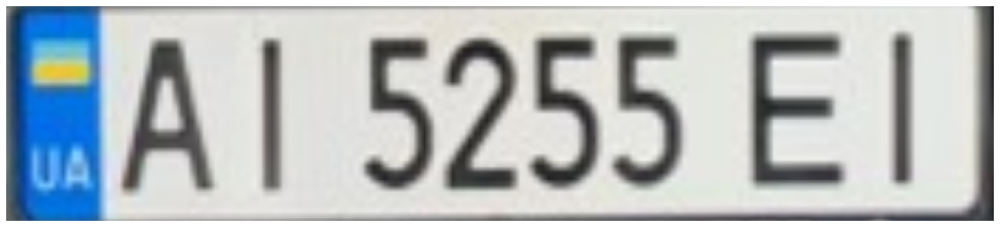

['AI5255EI']


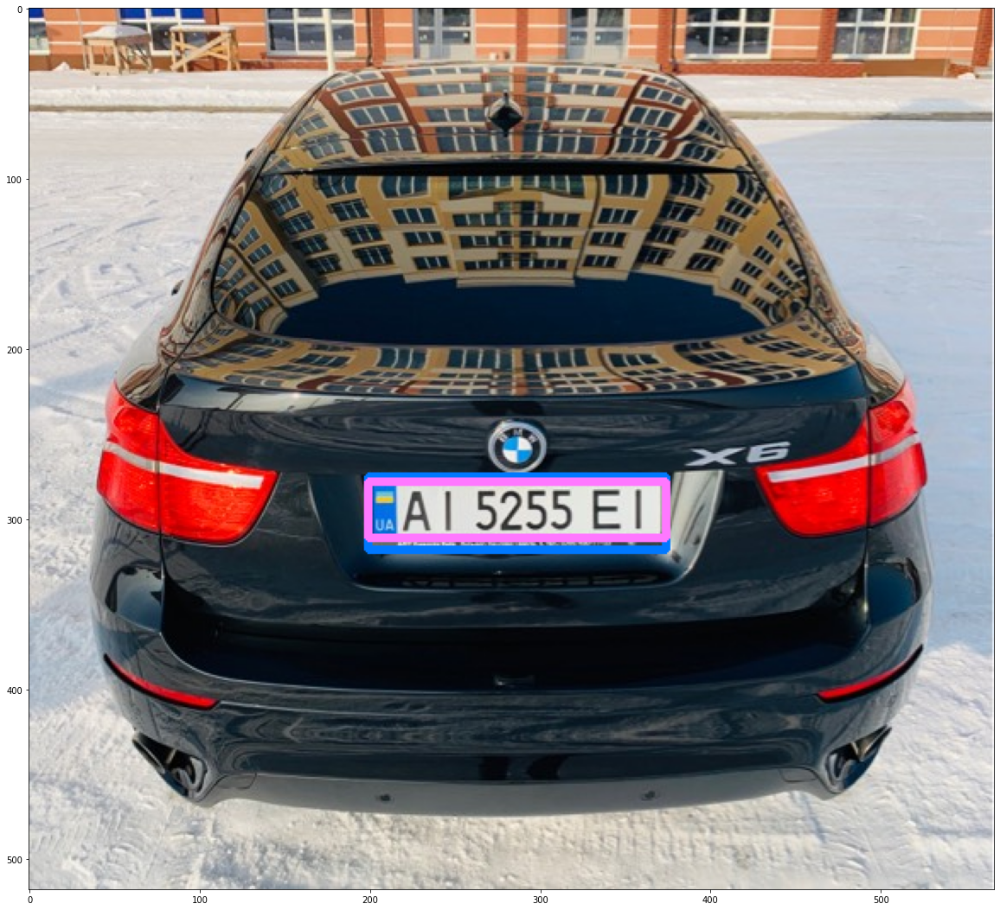

OK: TEXT:AI5255EI 			 RESULTS:['AI5255EI'] 
					 in PATH:./images/0.jpeg
__________ 		 ./images/1.jpeg 		 __________
all_points
[[[39.25638796071079, 518.5825339976421], [35.440327610913336, 476.77841979688765], [91.50560007853733, 528.3584891001813], [95.32165898518338, 570.1626023610004]]]
['eu_ua_2015']
[1]


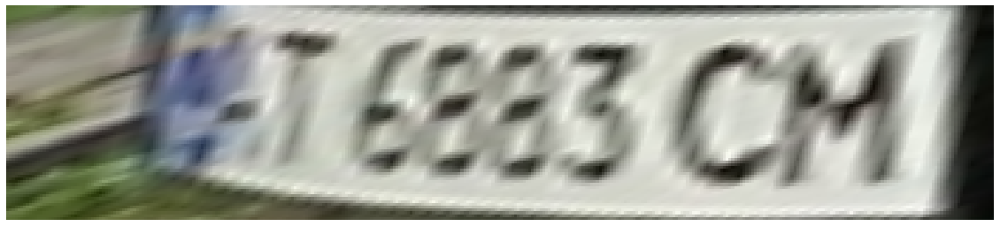

['AA76883CM']


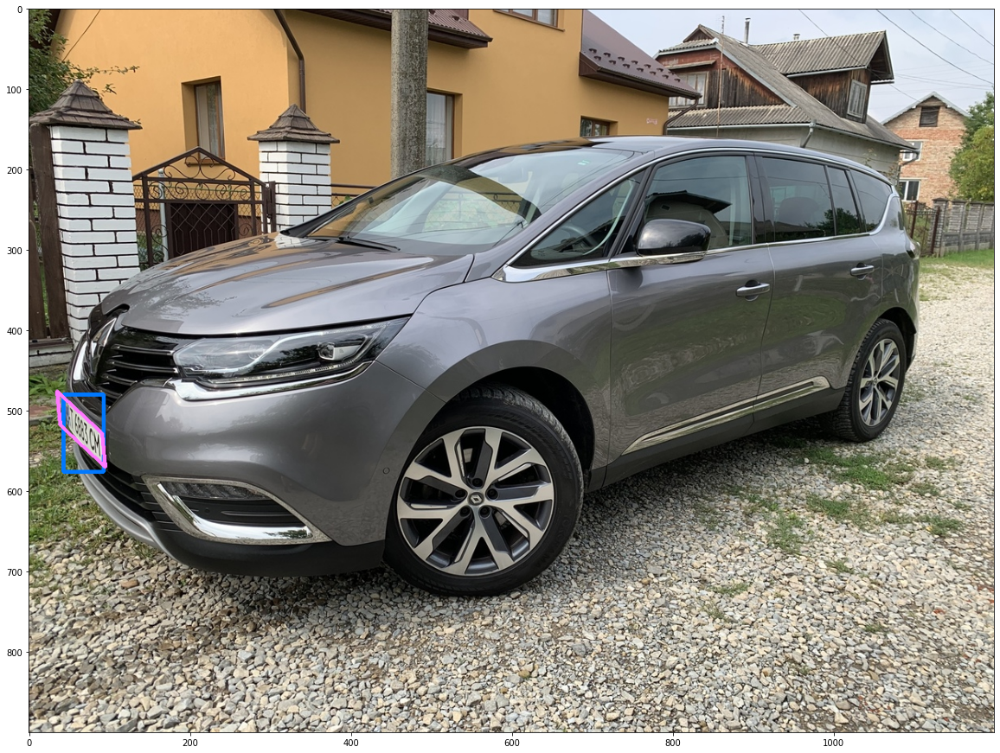

NOT OK: TEXT:AT6883CM 			 RESULTS:['AA76883CM'] 
					 in PATH:./images/1.jpeg 
__________ 		 ./images/2.jpeg 		 __________
all_points
[[[2785.003097971006, 1728.7630243557333], [2794.0002885562135, 1598.1436857532256], [3200.0943977645106, 1429.2540856263006], [3191.09719172596, 1559.8734285838086]], [[2457.4480484709475, 561.3527032419202], [2457.7818587668003, 532.9444540492754], [2564.7496428726513, 529.7983432526372], [2564.415831982257, 558.2065932212422]]]
['eu_ua_2015', 'eu']
[1, 1]


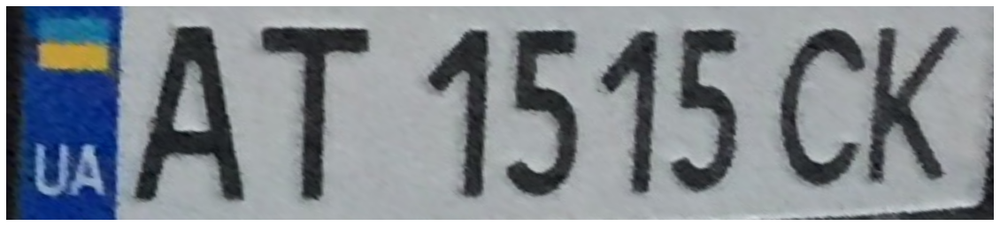

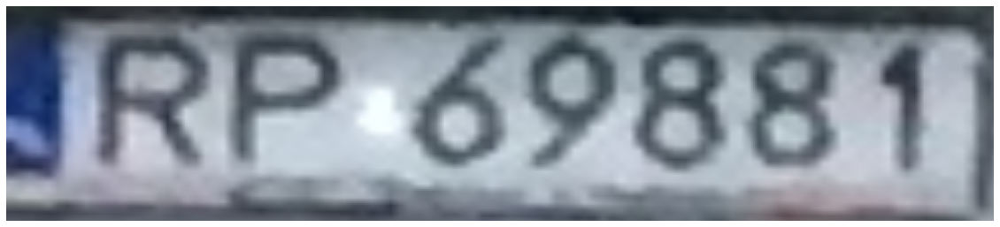

['AT1515CK', 'RP69881']


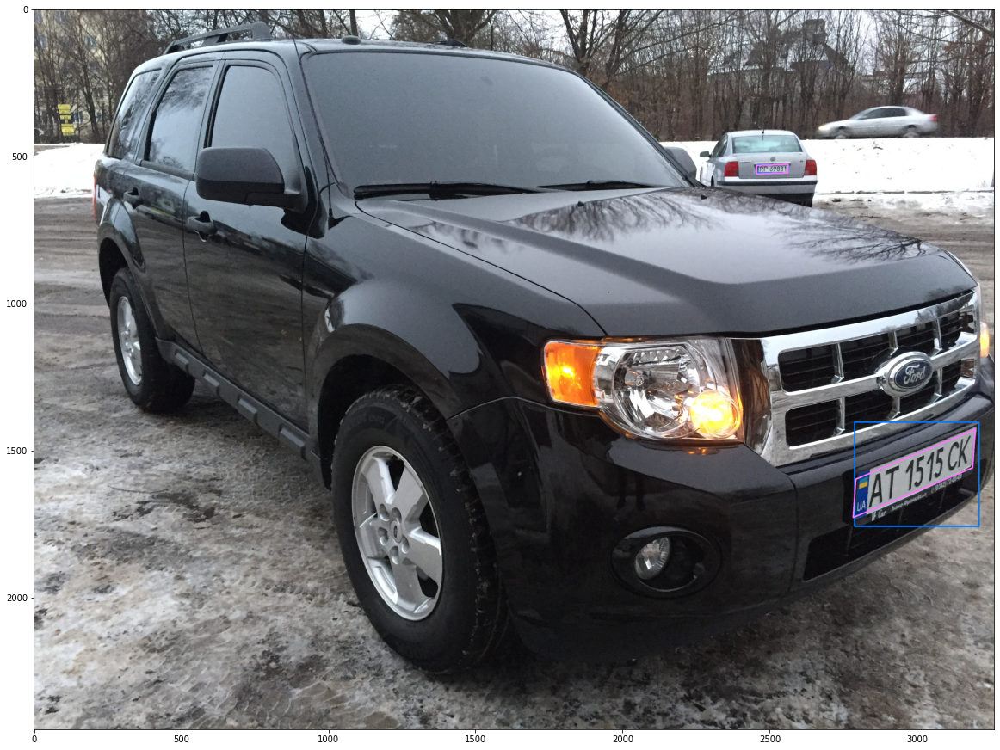

OK: TEXT:AT1515CK 			 RESULTS:['AT1515CK', 'RP69881'] 
					 in PATH:./images/2.jpeg
__________ 		 ./images/3.jpeg 		 __________
all_points
[[[909.6116074702868, 664.4192543049863], [914.6641740587211, 628.8893461212574], [998.8027137445752, 590.0561934448726], [993.7501504306166, 625.5860961729448]]]
['eu_ua_2015']
[1]


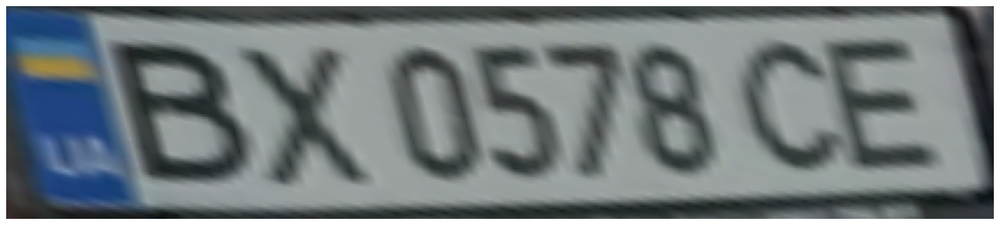

['BX0578CE']


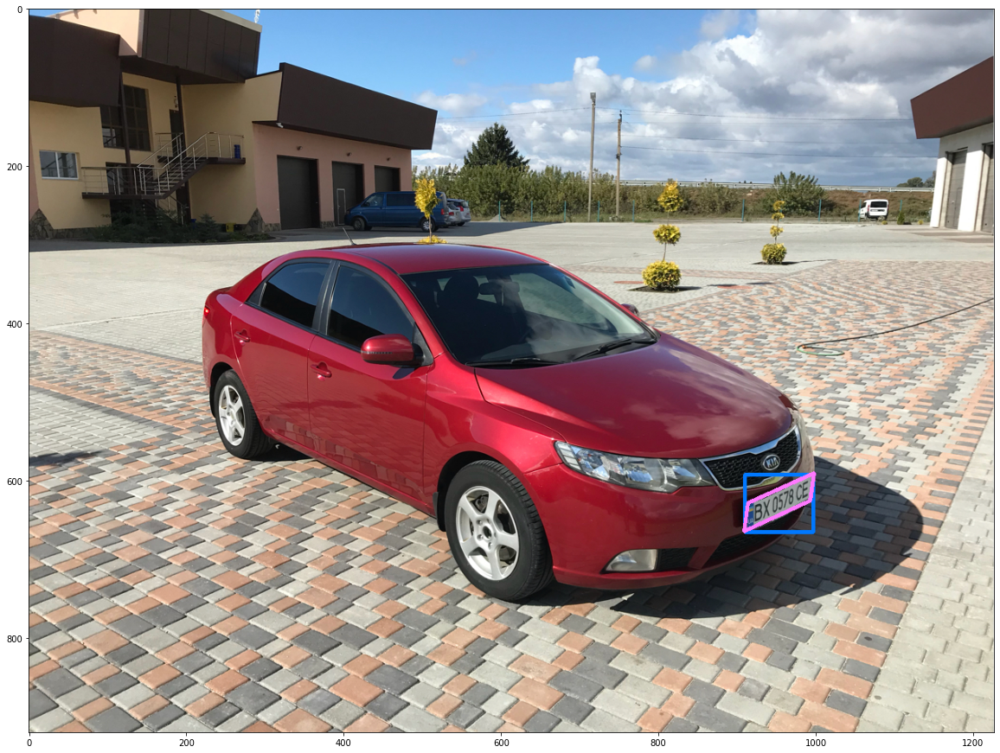

OK: TEXT:BX0578CE 			 RESULTS:['BX0578CE'] 
					 in PATH:./images/3.jpeg
__________ 		 ./images/4.jpeg 		 __________
all_points
[[[1120.7506667768087, 894.3539730147754], [1121.7515558125535, 845.3809387994908], [1338.2493426856622, 834.2785078982652], [1337.2484441874465, 883.2515432566798]]]
['eu_ua_2015']
[1]


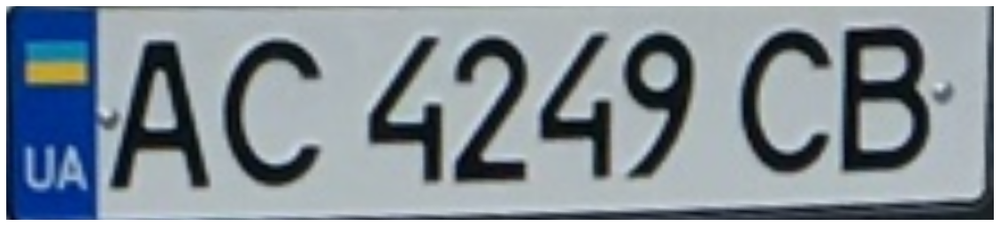

['AC4249CB']


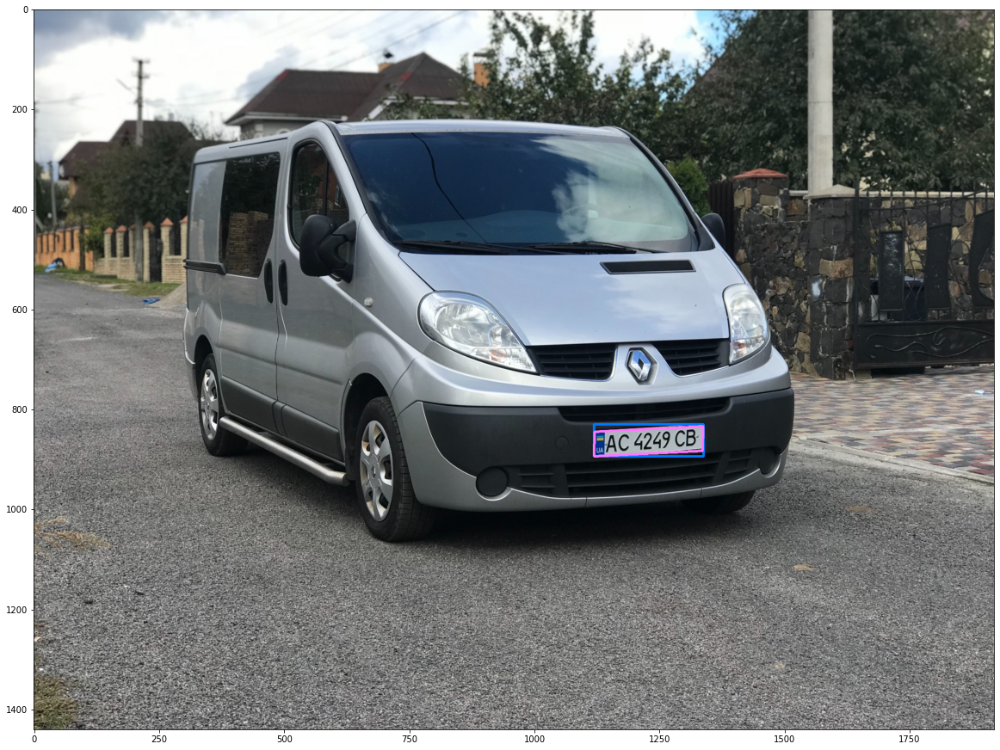

OK: TEXT:AC4249CB 			 RESULTS:['AC4249CB'] 
					 in PATH:./images/4.jpeg
__________ 		 ./images/5.jpeg 		 __________
all_points
[[[609.9821227633648, 1656.6092202707446], [626.855131226626, 1554.3510621770183], [899.3756638455797, 1631.7117077121095], [882.5026563667545, 1733.9698575556924]]]
['eu_ua_2015']
[1]


/var/www/nomeroff-net/NomeroffNet/../CRAFT-pytorch/craft_utils.py:239: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  polys = np.array(polys)


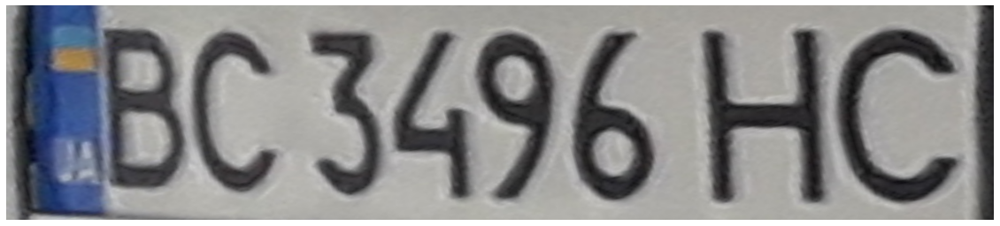

['BC3496HC']


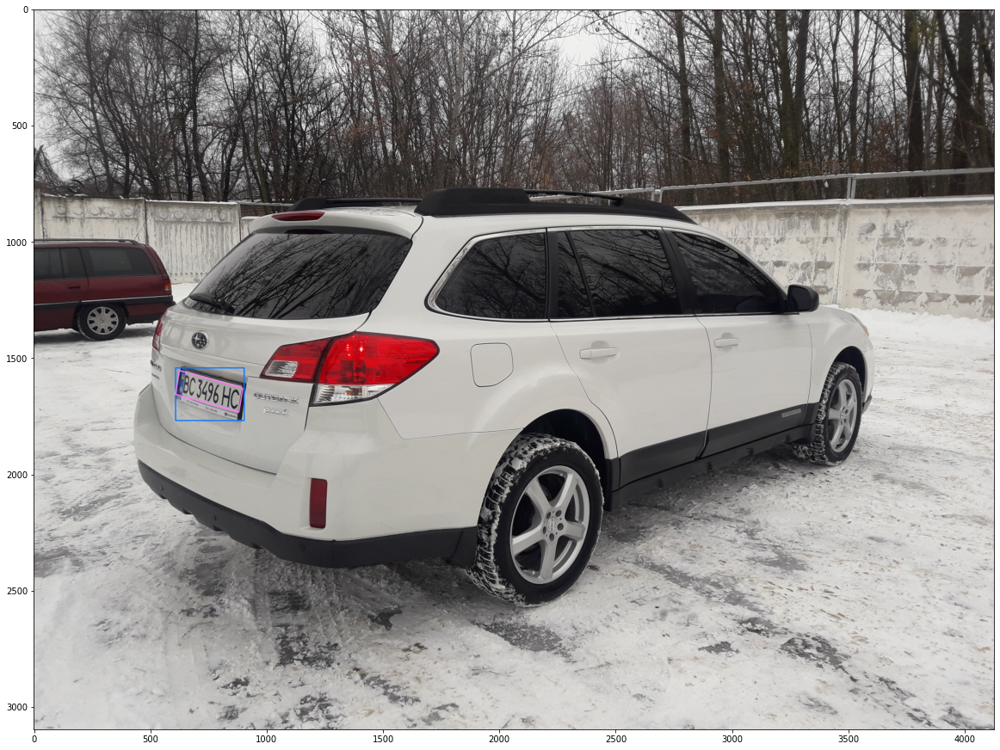

OK: TEXT:BC3496HC 			 RESULTS:['BC3496HC'] 
					 in PATH:./images/5.jpeg
__________ 		 ./images/6.jpeg 		 __________
all_points
[[[3358.514480662019, 1803.1532386689437], [3337.649063140865, 1678.550459952048], [3640.5994916520385, 1534.5248731633417], [3661.4649008772058, 1659.1276374502465]]]
['eu_ua_2015']
[1]


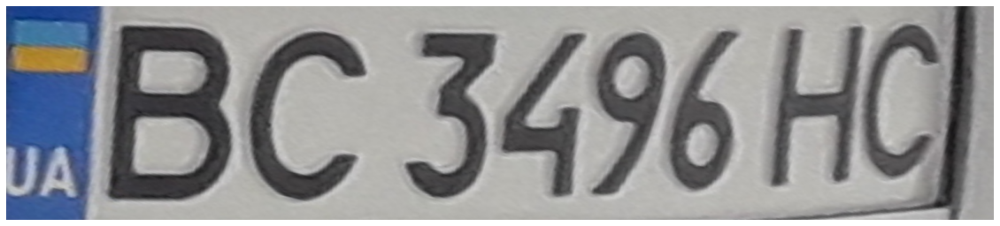

['BC3496HC']


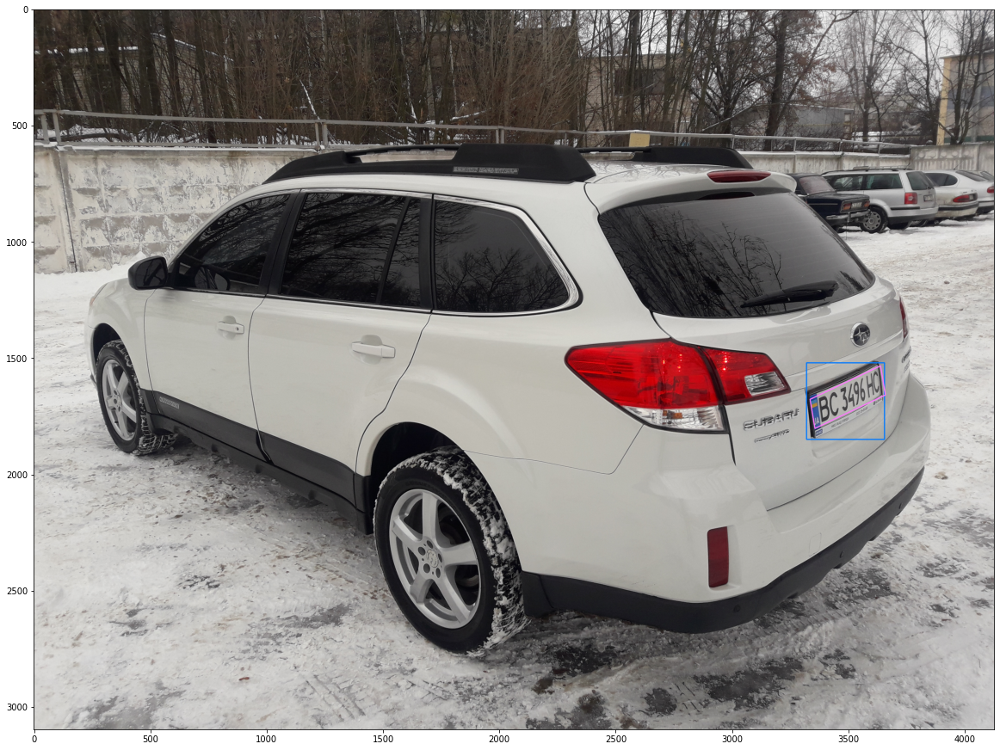

OK: TEXT:BC3496HC 			 RESULTS:['BC3496HC'] 
					 in PATH:./images/6.jpeg
__________ 		 ./images/7.jpeg 		 __________
all_points
[[[115.17739875637317, 734.2351253445088], [109.9331708955885, 675.145253929504], [365.8226012436268, 736.4886038422679], [371.066824420419, 795.5784762469758]]]
['eu_ua_2015']
[1]


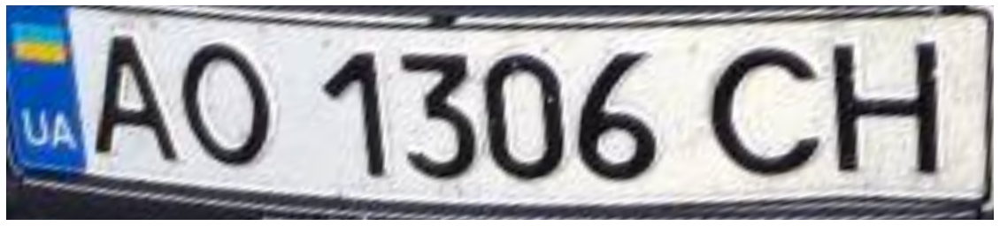

['AO1306CH']


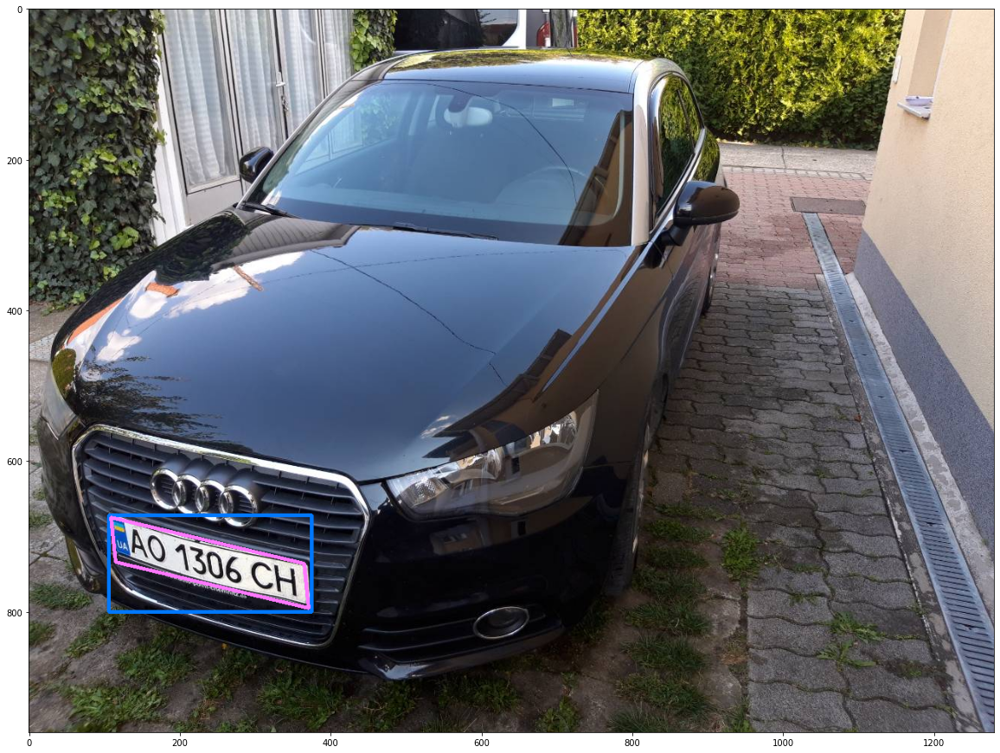

OK: TEXT:AO1306CH 			 RESULTS:['AO1306CH'] 
					 in PATH:./images/7.jpeg
__________ 		 ./images/8.jpeg 		 __________
all_points
[[[1067.7942560271886, 976.78714705191], [1070.1865973967735, 903.6609348996507], [1414.2057392449115, 875.2556703676948], [1411.8134026032265, 948.3818824917984]]]
['eu_ua_2004']
[1]


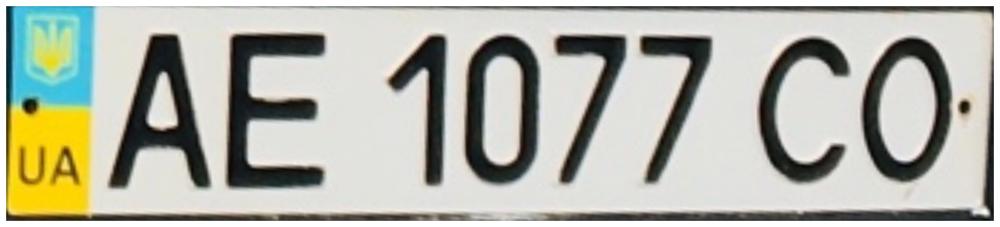

['AE1077CO']


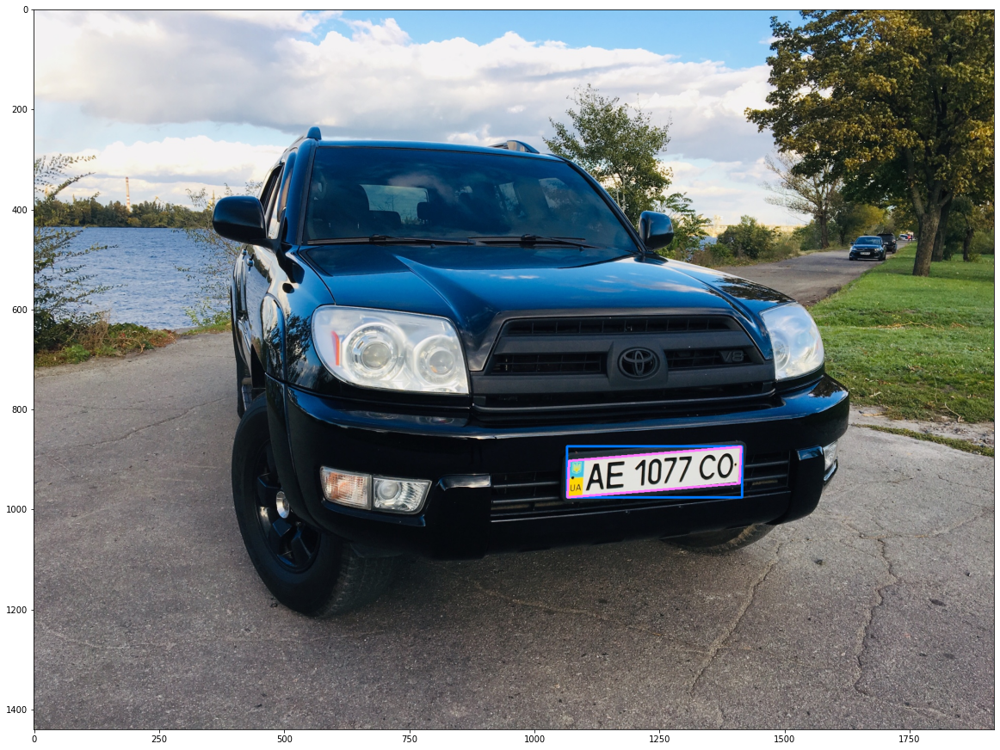

OK: TEXT:AE1077CO 			 RESULTS:['AE1077CO'] 
					 in PATH:./images/8.jpeg
__________ 		 ./images/9.jpeg 		 __________
all_points
[[[973.2516566587352, 857.6160472583479], [967.6946285176373, 812.6835492404274], [1157.6165224385356, 783.1811261135061], [1163.173562373367, 828.113623926533]]]
['eu_ua_2004']
[1]


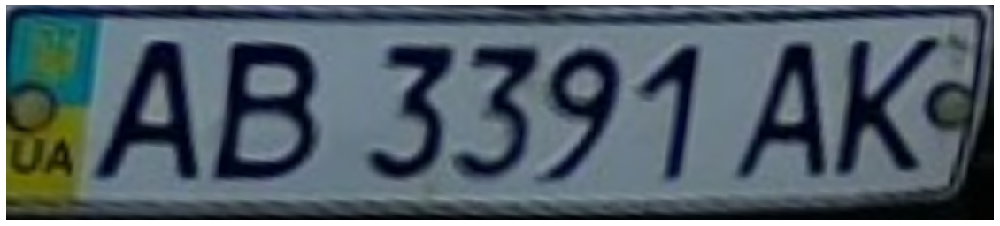

['AB3391AK']


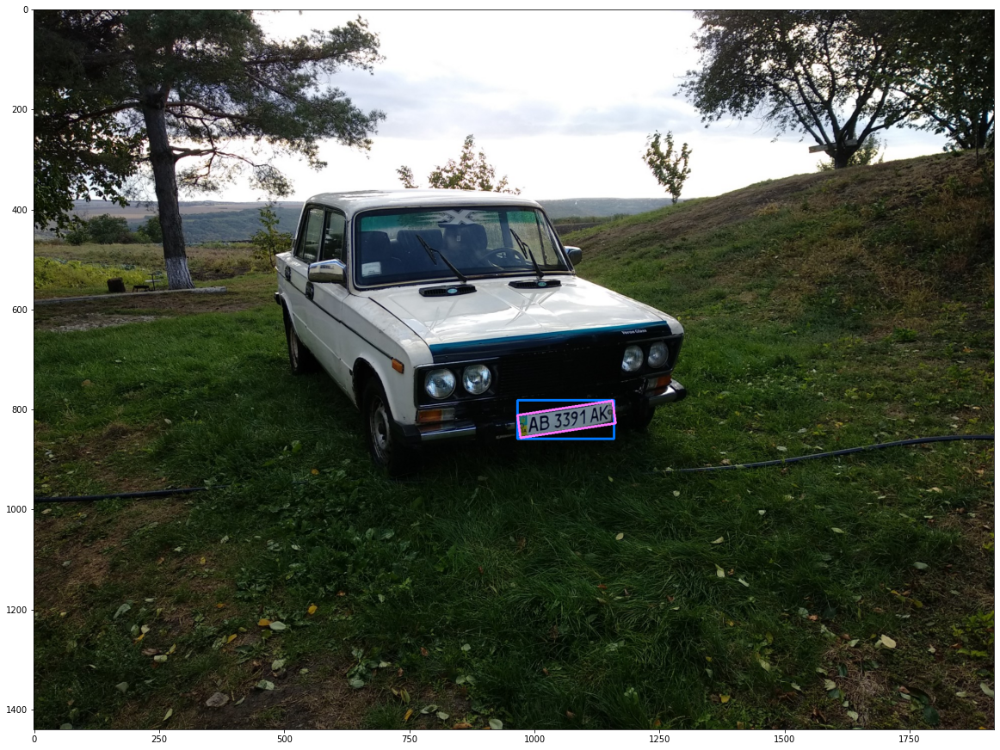

OK: TEXT:AB3391AK 			 RESULTS:['AB3391AK'] 
					 in PATH:./images/9.jpeg
__________ 		 ./images/10.jpeg 		 __________
all_points
[[[1048.677888589037, 571.3474975044389], [1054.7336080821133, 525.0212216667232], [1161.4876396985217, 482.319617081569], [1155.431915918186, 528.6458955525767]]]
['eu_ua_2015']
[1]


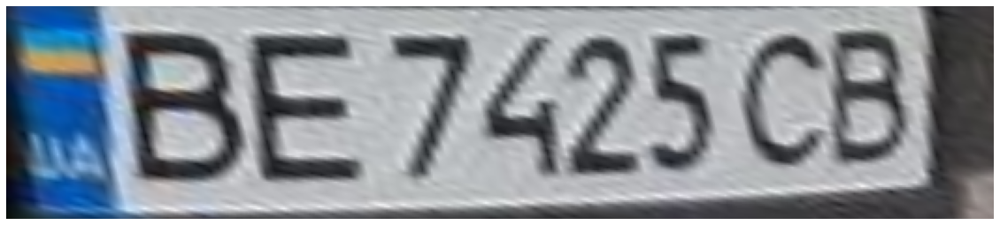

['BE7425CB']


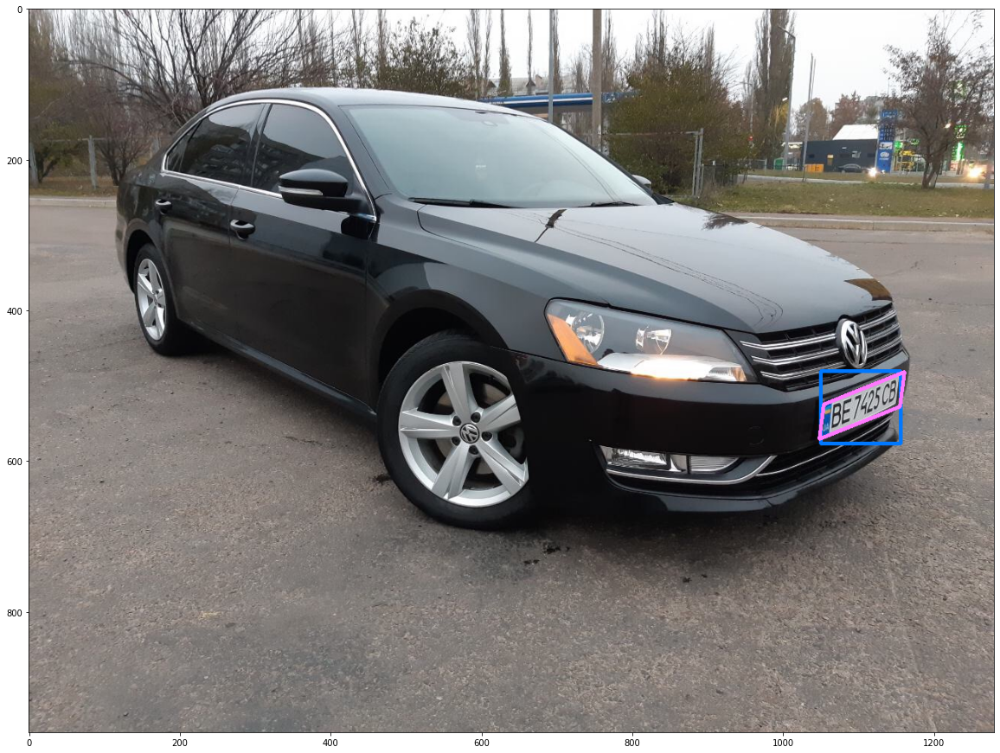

OK: TEXT:BE7425CB 			 RESULTS:['BE7425CB'] 
					 in PATH:./images/10.jpeg
__________ 		 ./images/11.jpeg 		 __________
all_points
[[[1135.656007076347, 372.6719953515062], [1128.0826748977065, 329.1253288474551], [1208.5466754645468, 288.8933333154192], [1216.120011547172, 332.44000127954575]]]
['eu_ua_2015']
[1]


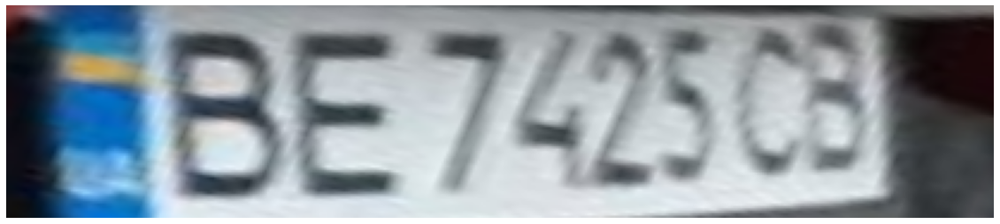

['BE7425CB']


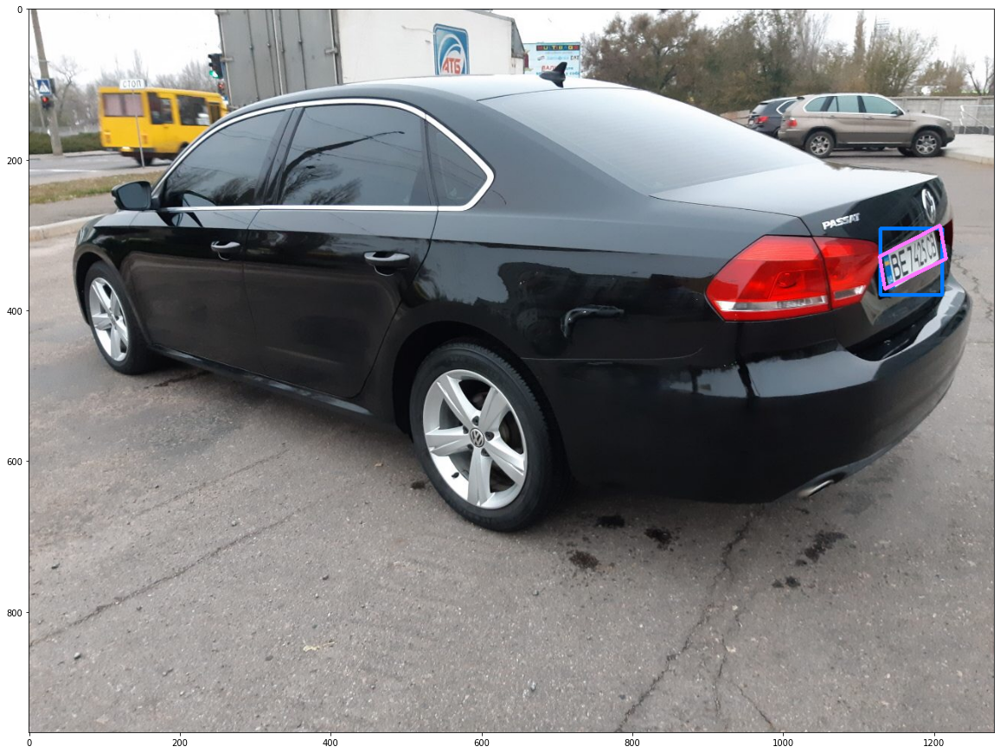

OK: TEXT:BE7425CB 			 RESULTS:['BE7425CB'] 
					 in PATH:./images/11.jpeg
__________ 		 ./images/12.jpeg 		 __________
all_points
[[[52.55774470131214, 369.8139497623946], [47.59528248559511, 338.17825564790246], [120.26748433538583, 379.70522944548054], [125.22995211762654, 411.3409246999803]]]
['eu_ua_2015']
[1]


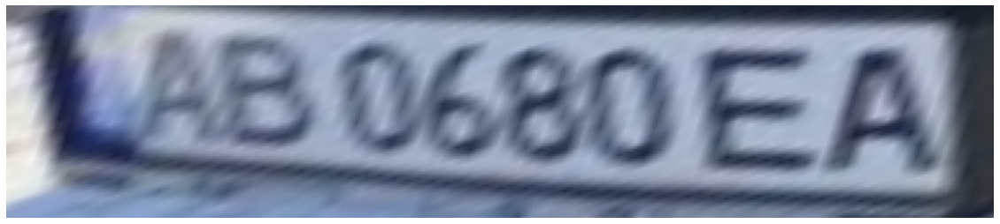

['AB0680EA']


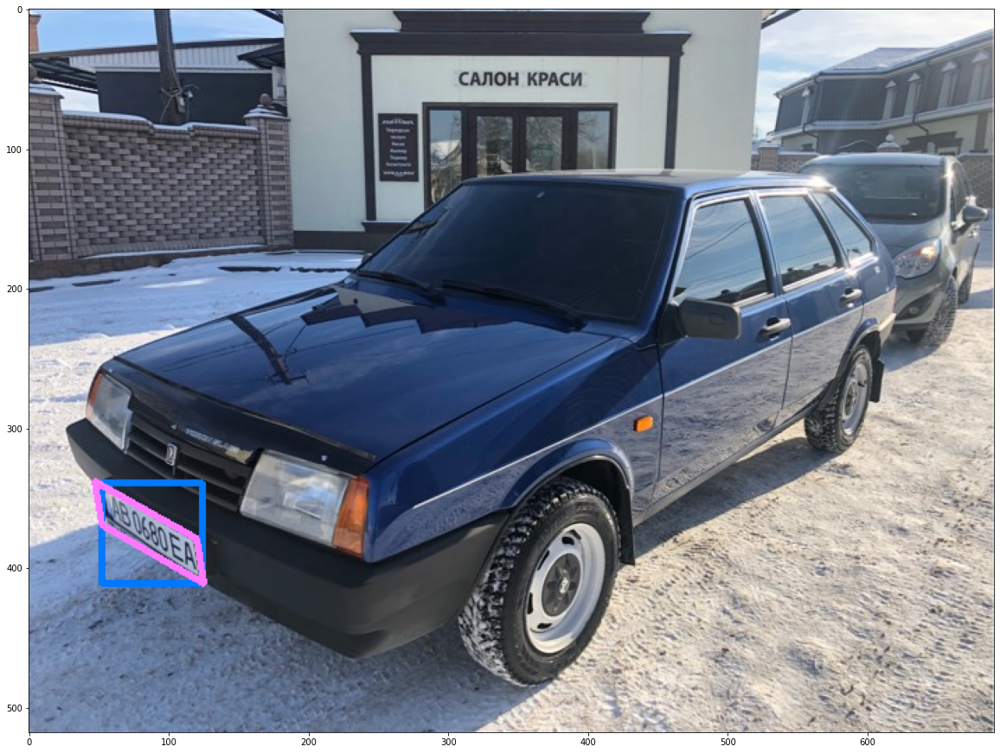

OK: TEXT:AB0680EA 			 RESULTS:['AB0680EA'] 
					 in PATH:./images/12.jpeg
__________ 		 ./images/13.jpeg 		 __________
all_points
[[[137.3810833392762, 422.96813017455725], [135.92072222618413, 394.00653291009854], [271.6189166607238, 431.3235404665746], [273.07927672514904, 460.2851397965422]]]
['eu_ua_2015']
[1]


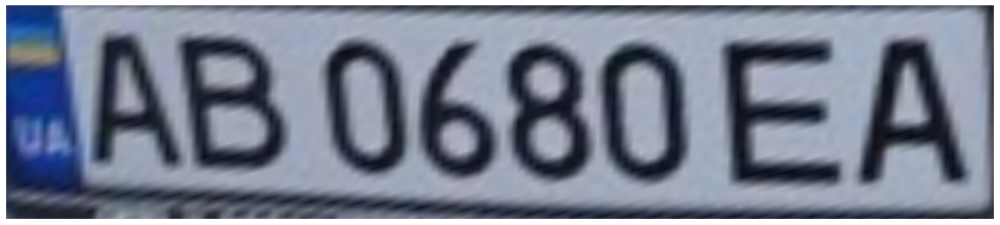

['AB0680EA']


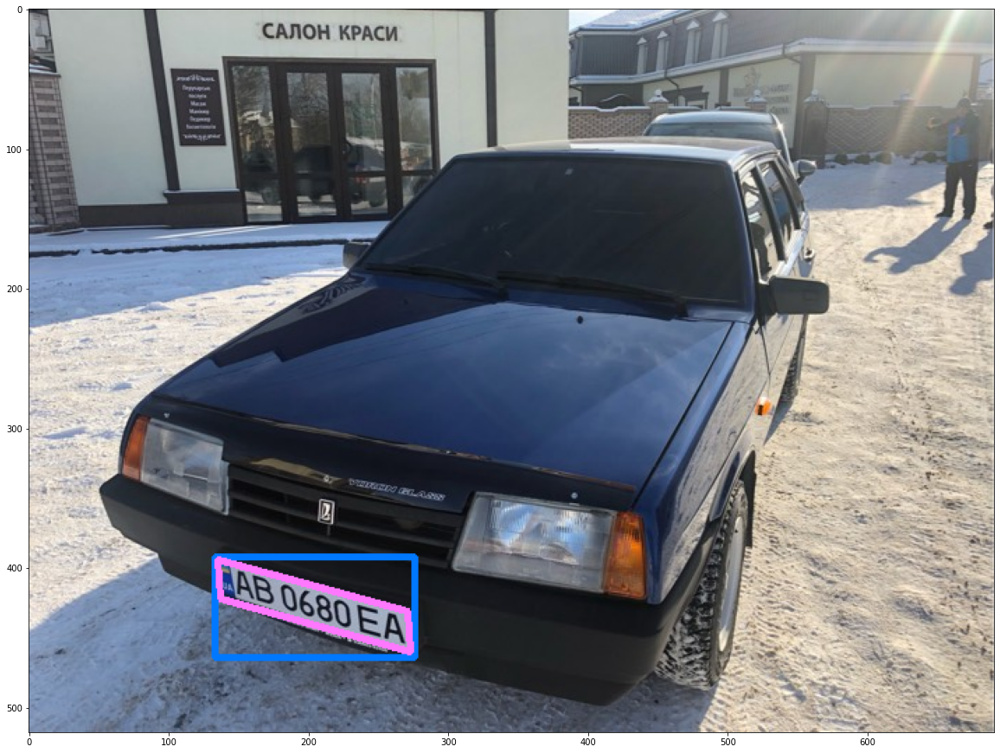

OK: TEXT:AB0680EA 			 RESULTS:['AB0680EA'] 
					 in PATH:./images/13.jpeg
__________ 		 ./images/14.jpeg 		 __________
all_points
[[[167.13761357240378, 824.134371098075], [165.91612010245876, 776.3571790735356], [419.8623864275962, 792.682296499124], [421.0838751836766, 840.459492999402]]]
['eu_ua_2015']
[1]


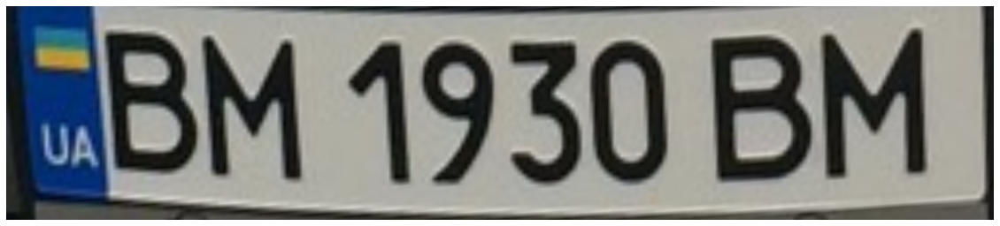

['BM1930BM']


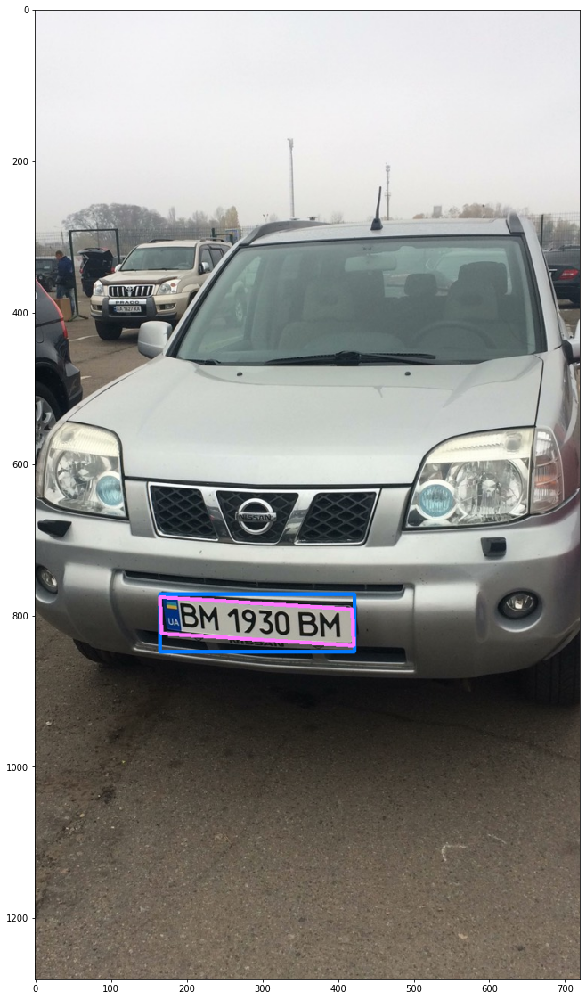

OK: TEXT:BM1930BM 			 RESULTS:['BM1930BM'] 
					 in PATH:./images/14.jpeg
__________ 		 ./images/15.jpeg 		 __________
all_points
[[[623.3597173202073, 992.6360230268377], [626.186272796013, 960.1587593694685], [731.8800833931458, 983.8487571984432], [729.0535311240133, 1016.3260219135437]]]
['eu_ua_2015']
[1]


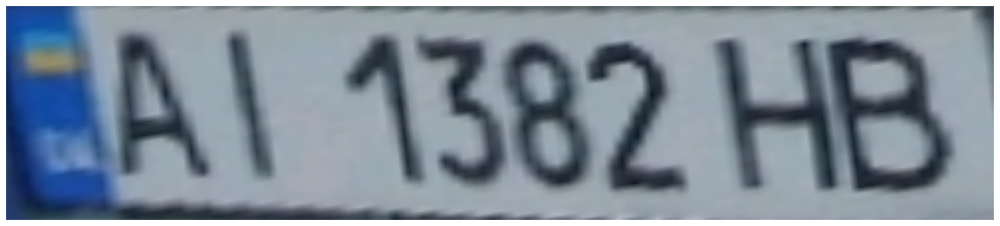

['AI1382HB']


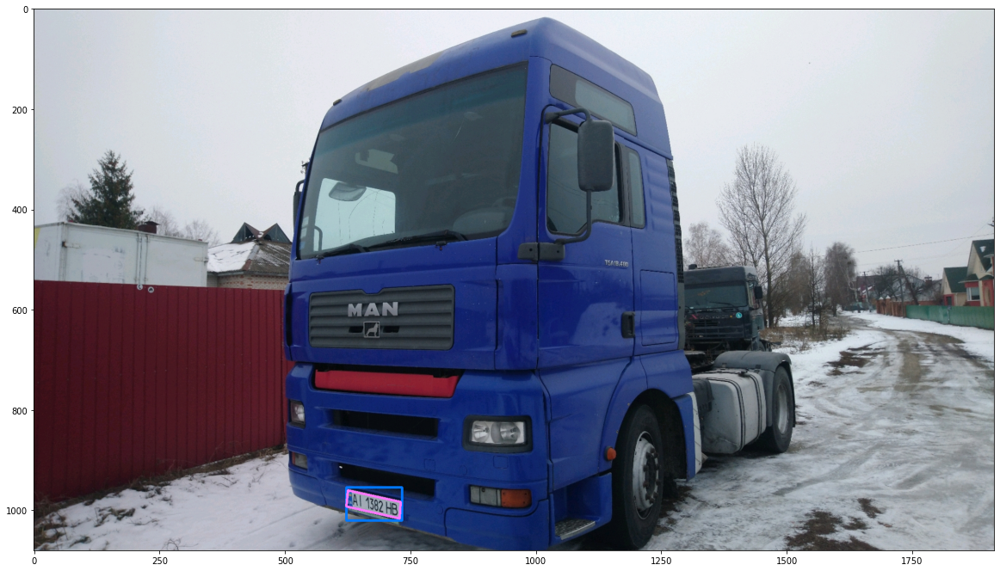

OK: TEXT:AI1382HB 			 RESULTS:['AI1382HB'] 
					 in PATH:./images/15.jpeg
__________ 		 ./images/16.jpeg 		 __________
all_points
[[[1711.049119683101, 972.1024691100548], [1711.049119683101, 905.8604701722529], [1841.0594320108885, 856.7999535373242], [1841.0594327666358, 923.0419555593234]]]
['eu_ua_2015']
[1]


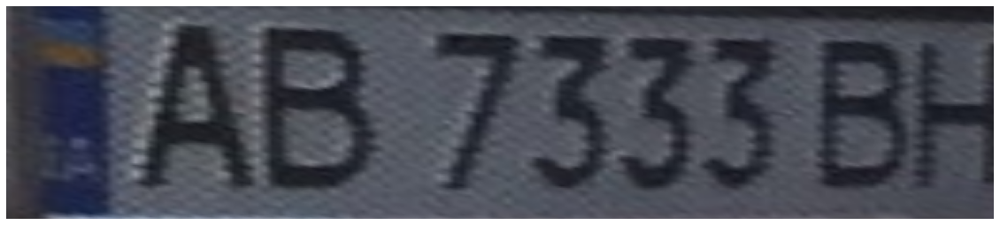

['AB7333BH']


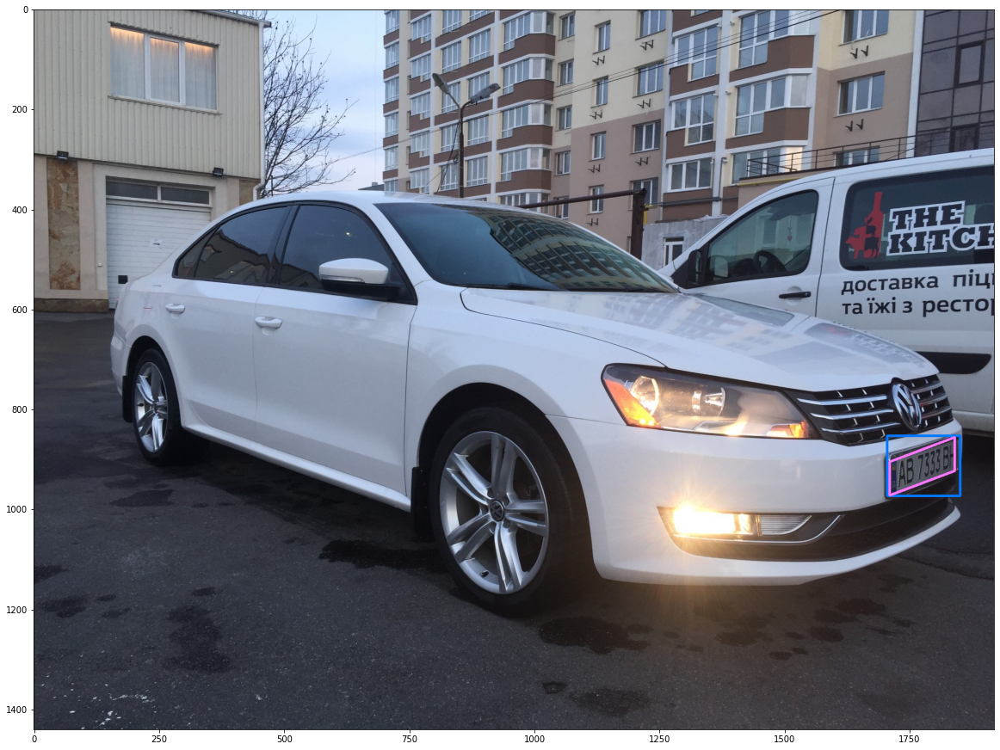

OK: TEXT:AB7333BH 			 RESULTS:['AB7333BH'] 
					 in PATH:./images/16.jpeg
__________ 		 ./images/17.jpeg 		 __________
all_points
[[[637.7956332372279, 953.3943175248507], [638.1934498558418, 917.4581440336478], [799.2043714860288, 908.5130846748355], [798.8065501441582, 944.4492571089048]]]
['eu_ua_2015']
[1]


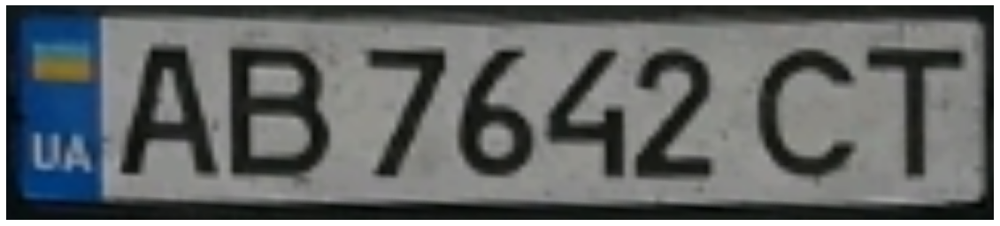

['AB7642CT']


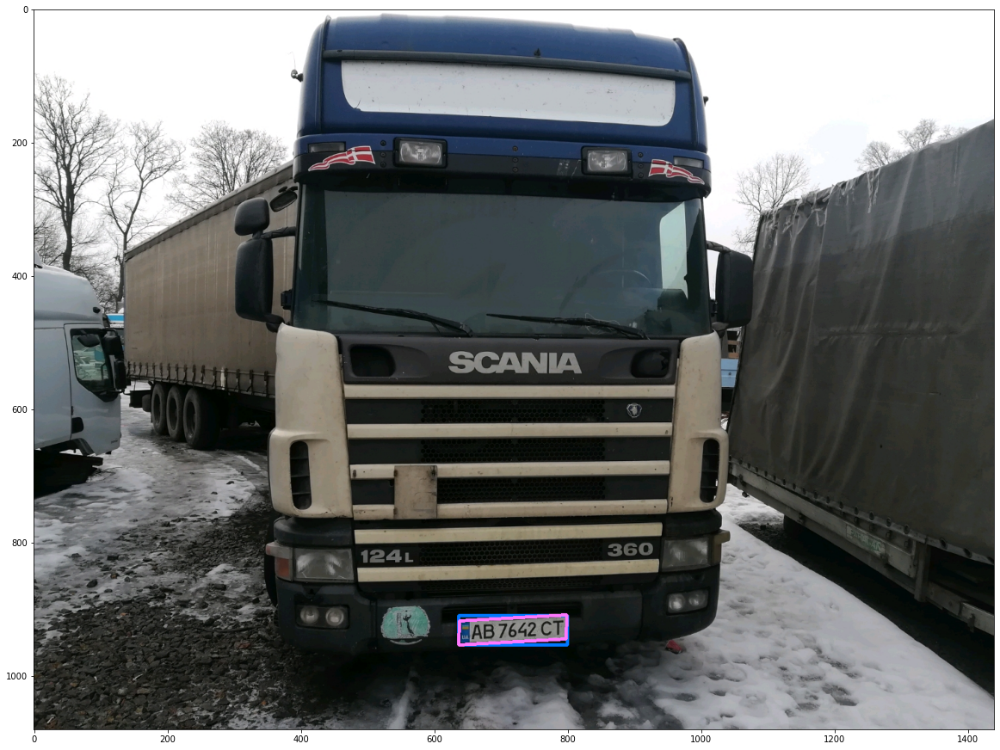

OK: TEXT:AB7642CT 			 RESULTS:['AB7642CT'] 
					 in PATH:./images/17.jpeg
__________ 		 ./images/18.jpeg 		 __________
all_points
[[[875.5882751689574, 570.3651694196417], [873.0588501126383, 512.5237563404486], [1080.4117333720665, 465.30478657267616], [1082.9411498873617, 523.1461986008717]]]
['eu_ua_2015']
[1]


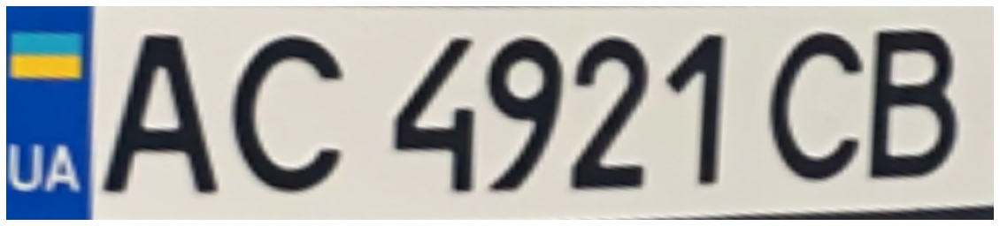

['AC4921CB']


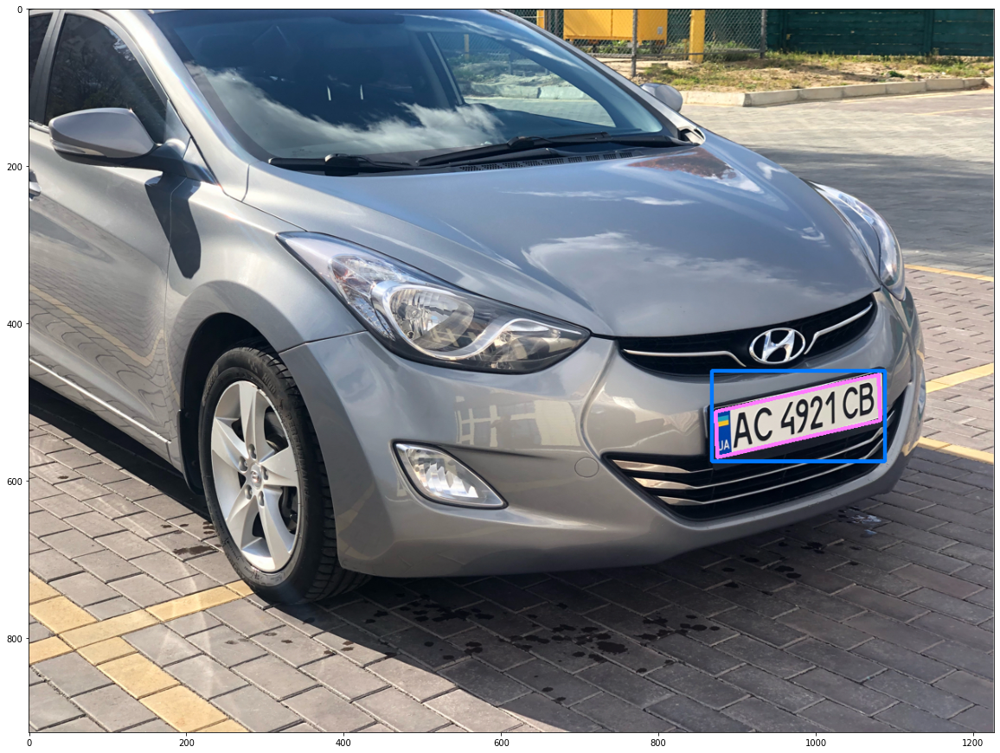

OK: TEXT:AC4921CB 			 RESULTS:['AC4921CB'] 
					 in PATH:./images/18.jpeg
__________ 		 ./images/19.jpeg 		 __________
all_points
[[[1537.0, 1498.5875425859235], [1539.9192486467862, 1350.2964916331223], [2410.0, 1367.424778083432], [2407.080732436253, 1515.7158430268844]]]
['eu_ua_2015']
[1]


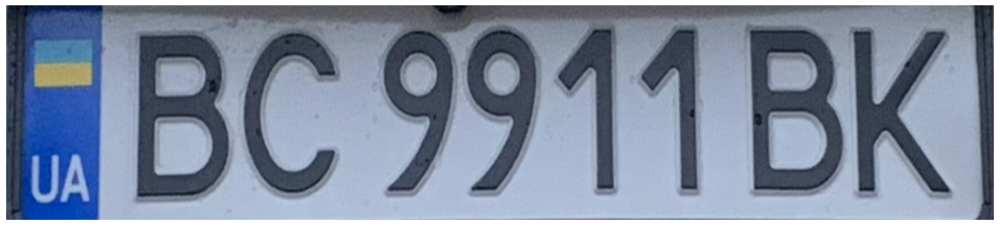

['BC9911BK']


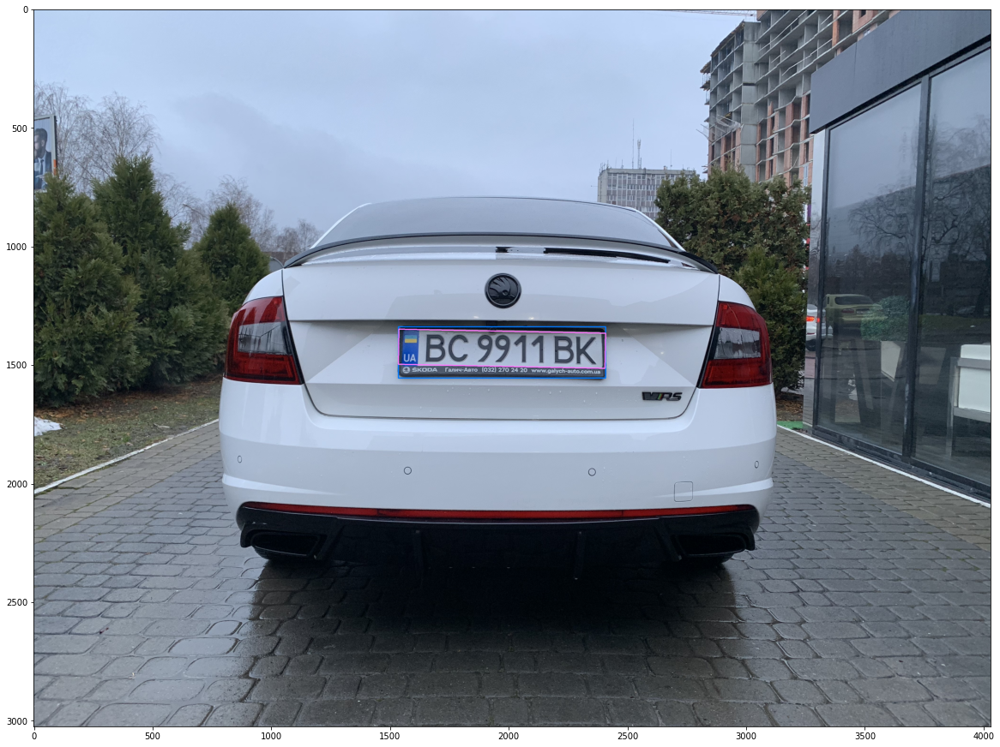

OK: TEXT:BC9911BK 			 RESULTS:['BC9911BK'] 
					 in PATH:./images/19.jpeg
__________ 		 ./images/20.jpeg 		 __________
all_points
[[[753.0, 2229.5253935098235], [766.9778964149258, 2161.7066912725104], [997.0, 2209.115833779188], [983.0221142664361, 2276.9345416230904]], [[377.65908514195115, 1682.6244056564035], [377.07323168243903, 1659.1860438800568], [494.34091723431305, 1655.5214303202308], [494.92676831756097, 1678.9597905571657]]]
['eu_ua_2015', 'kg']
[1, 1]


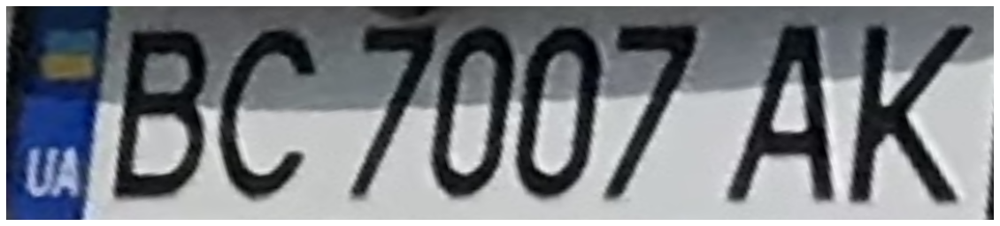

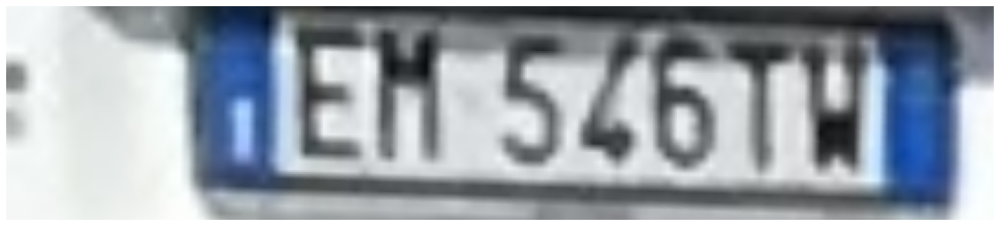

['BC7007AK', '']


In [ ]:
testData = {
    "0.jpeg": ["AI5255EI"],
    "1.jpeg": ["AT6883CM"],
    "2.jpeg": ["AT1515CK"],
    "3.jpeg": ["BX0578CE"],
    "4.jpeg": ["AC4249CB"],
    "5.jpeg": ["BC3496HC"],
    "6.jpeg": ["BC3496HC"],
    "7.jpeg": ["AO1306CH"],
    "8.jpeg": ["AE1077CO"],
    "9.jpeg": ["AB3391AK"],
    "10.jpeg": ["BE7425CB"],
    "11.jpeg": ["BE7425CB"],
    "12.jpeg": ["AB0680EA"],
    "13.jpeg": ["AB0680EA"],
    "14.jpeg": ["BM1930BM"],
    "15.jpeg": ["AI1382HB"],
    "16.jpeg": ["AB7333BH"],
    "17.jpeg": ["AB7642CT"],
    "18.jpeg": ["AC4921CB"],
    "19.jpeg": ["BC9911BK"],
    "20.jpeg": ["BC7007AK"],
    "21.jpeg": ["AB5649CI"],
    "22.jpeg": ["AX2756EK"],
    "23.jpeg": ["AA7564MX"],
    "24.jpeg": ["AM5696CK"],
    "25.jpeg": ["AM5696CK"],
}

%matplotlib inline
plt.rcParams["figure.figsize"]  = (20, 20)    

gGood = 0
gBad = 0
i = 0
for fileName in testData.keys():
    nGood, nBad = await test(dirName, fileName, testData[fileName], verbose=1)
    gGood += nGood
    gBad += nBad
    i += 1
total = gGood + gBad
print(f"TOTAL GOOD: {gGood/total}")
print(f"TOTAL BED: {gBad/total}")